# EDA on the Dataset

In [2]:
import os
import pandas as pd
import json

In [3]:
def read_json_files(dir_path):
    json_files = [pos_json for pos_json in os.listdir(dir_path) if pos_json.endswith('.json')]
    json_data = []

    for json_file in json_files:
        with open(os.path.join(dir_path, json_file), 'r') as file:
            data = json.load(file)
            json_data.append(data)
    
    return json_data


In [4]:
def parse_vantage_api_data(json_data: list) -> pd.DataFrame:
    df_list = []
    for json_dict in json_data:
        for item in json_dict['feed']:
            item_dict = {
                'title': item['title'], 
                'time_published': item['time_published'], 
                'summary': item['summary'],
                'overall_sentiment_label': item['overall_sentiment_label'],
                'ticker_sentiment': item['ticker_sentiment']
            }
            df_list.append(item_dict)
    return pd.DataFrame(df_list)


In [5]:
dir_path = '/Users/naderlobandi/Desktop/data'

json_data = read_json_files(dir_path)
df = parse_vantage_api_data(json_data)

df.head()

,title,time_published,summary,overall_sentiment_label,ticker_sentiment
0,Crypto recruitment execs reveal the safest job...,20230118T000000,The crypto industry has already seen more than...,Somewhat-Bearish,"[{'ticker': 'COIN', 'relevance_score': '0.1408..."
1,Apparel sales slow down on price pressures | T...,20230118T000000,Apparel sales slow down on price pressures The...,Neutral,[]
2,SmartCentres Declares Distribution for January...,20230117T235700,"TORONTO, Jan. 17, 2023 ( GLOBE NEWSWIRE ) -- S...",Neutral,"[{'ticker': 'CWYUF', 'relevance_score': '0.086..."
3,"Jim Cramer picks his favorite travel, restaura...",20230117T235533,"""The biggest theme is the rise of this 'life i...",Somewhat-Bullish,"[{'ticker': 'HLT', 'relevance_score': '0.09150..."
4,Jaguars 27-Point Comeback Costs Sports Bettor ...,20230117T235357,"Have you heard the phrase ""a sure thing"" in sp...",Somewhat-Bullish,"[{'ticker': 'DKNG', 'relevance_score': '0.2691..."


In [6]:
# checking for missing valus and data types and dimension
print(f"Number of rows: {df.shape[0]}, Number of columns: {df.shape[1]}")

df.info()

missing_values = df.isnull().sum()
print(f"Missing values in each column:\n{missing_values}")

Number of rows: 77583, Number of columns: 5
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77583 entries, 0 to 77582
Data columns (total 5 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   title                    77583 non-null  object
 1   time_published           77583 non-null  object
 2   summary                  77583 non-null  object
 3   overall_sentiment_label  77583 non-null  object
 4   ticker_sentiment         77583 non-null  object
dtypes: object(5)
memory usage: 3.0+ MB
Missing values in each column:
title                      0
time_published             0
summary                    0
overall_sentiment_label    0
ticker_sentiment           0
dtype: int64


No missing values with 77,583 rows and 5 cols.

In [7]:
df['time_published'] = pd.to_datetime(df['time_published'], format='%Y%m%dT%H%M%S')

print(df['time_published'].head())

0   2023-01-18 00:00:00
1   2023-01-18 00:00:00
2   2023-01-17 23:57:00
3   2023-01-17 23:55:33
4   2023-01-17 23:53:57
Name: time_published, dtype: datetime64[ns]


In [8]:
# flattening the ticker_sentiment column, list of dictionaries
tickers_df = df.explode('ticker_sentiment').dropna(subset=['ticker_sentiment'])

tickers_df = pd.concat([tickers_df.drop(['ticker_sentiment'], axis=1), tickers_df['ticker_sentiment'].apply(pd.Series)], axis=1)

tickers_df['ticker_sentiment_score'] = pd.to_numeric(tickers_df['ticker_sentiment_score'], errors='coerce')

print(tickers_df.head())


                                               title      time_published  \
0  Crypto recruitment execs reveal the safest job... 2023-01-18 00:00:00   
2  SmartCentres Declares Distribution for January... 2023-01-17 23:57:00   
3  Jim Cramer picks his favorite travel, restaura... 2023-01-17 23:55:33   
3  Jim Cramer picks his favorite travel, restaura... 2023-01-17 23:55:33   
3  Jim Cramer picks his favorite travel, restaura... 2023-01-17 23:55:33   

                                             summary overall_sentiment_label  \
0  The crypto industry has already seen more than...        Somewhat-Bearish   
2  TORONTO, Jan. 17, 2023 ( GLOBE NEWSWIRE ) -- S...                 Neutral   
3  "The biggest theme is the rise of this 'life i...        Somewhat-Bullish   
3  "The biggest theme is the rise of this 'life i...        Somewhat-Bullish   
3  "The biggest theme is the rise of this 'life i...        Somewhat-Bullish   

  ticker relevance_score  ticker_sentiment_score ticker_sentim

In [9]:
# check for duplicates
duplicate_rows = tickers_df.duplicated()
print(f"Number of duplicate rows: {duplicate_rows.sum()}")

tickers_df = tickers_df.drop_duplicates()


Number of duplicate rows: 1446


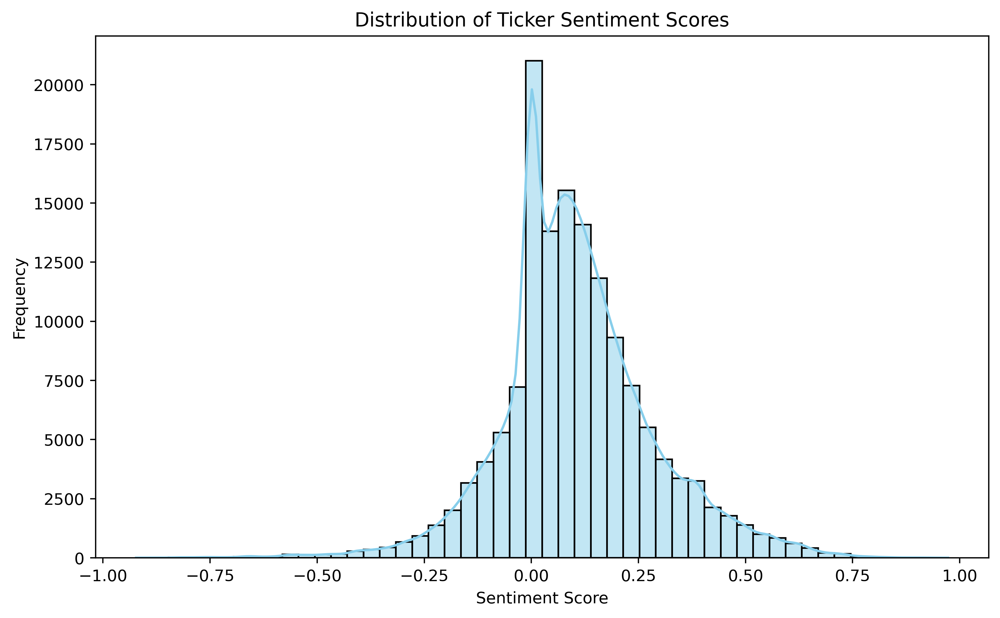

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns

# Distribution of ticker sentiment scores
plt.figure(figsize=(10, 6), dpi = 400)
sns.histplot(tickers_df['ticker_sentiment_score'], bins=50, color='skyblue', kde=True)
plt.title('Distribution of Ticker Sentiment Scores')
plt.xlabel('Sentiment Score')
plt.ylabel('Frequency')
plt.show()


<ipython-input-34-f4aae3d6915b>:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(y='overall_sentiment_label', data=df,
<ipython-input-34-f4aae3d6915b>:11: UserWarning: The palette list has more values (6) than needed (5), which may not be intended.
  sns.countplot(y='overall_sentiment_label', data=df,


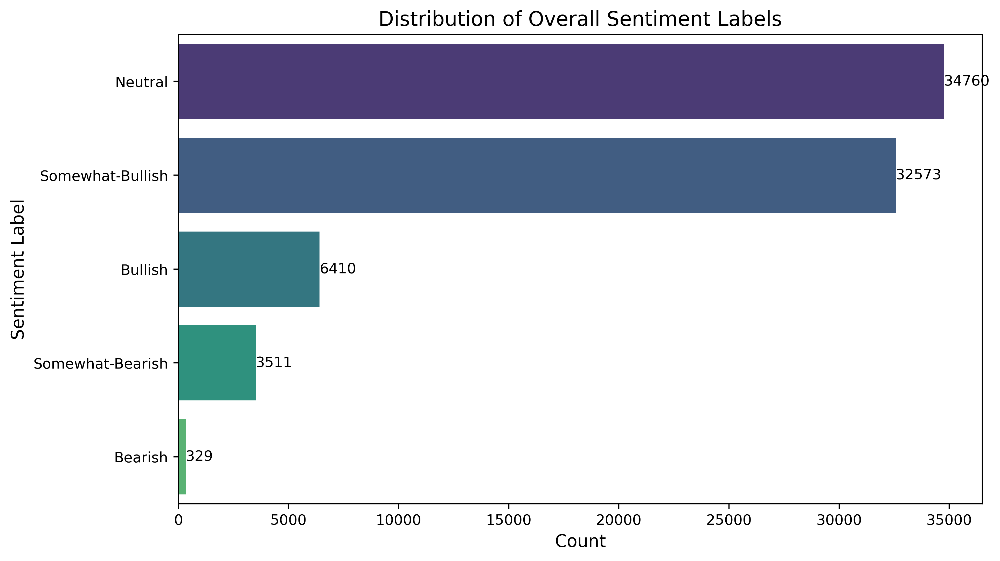

In [34]:
import seaborn as sns
import matplotlib.pyplot as plt

# Increase the resolution of the plot
plt.figure(figsize=(10, 6), dpi=400)

# Use a different color palette
palette = sns.color_palette("viridis")

# Distribution of sentiment labels
sns.countplot(y='overall_sentiment_label', data=df, 
              order=df['overall_sentiment_label'].value_counts().index, 
              palette=palette)

# Add annotations to the bars
for index, value in enumerate(df['overall_sentiment_label'].value_counts()):
    plt.text(value, index, f'{value}', va='center')

plt.title('Distribution of Overall Sentiment Labels', fontsize=14)
plt.xlabel('Count', fontsize=12)
plt.ylabel('Sentiment Label', fontsize=12)

# plt.savefig('sentiment_distribution.png', bbox_inches='tight')

plt.show()


Most common tickers:
ticker
META          3572
GOOG          3277
CRYPTO:BTC    2726
TSLA          2666
MSFT          2069
CRYPTO:ETH    1983
FOREX:USD     1793
GS            1479
MS            1396
WBD           1333
Name: count, dtype: int64


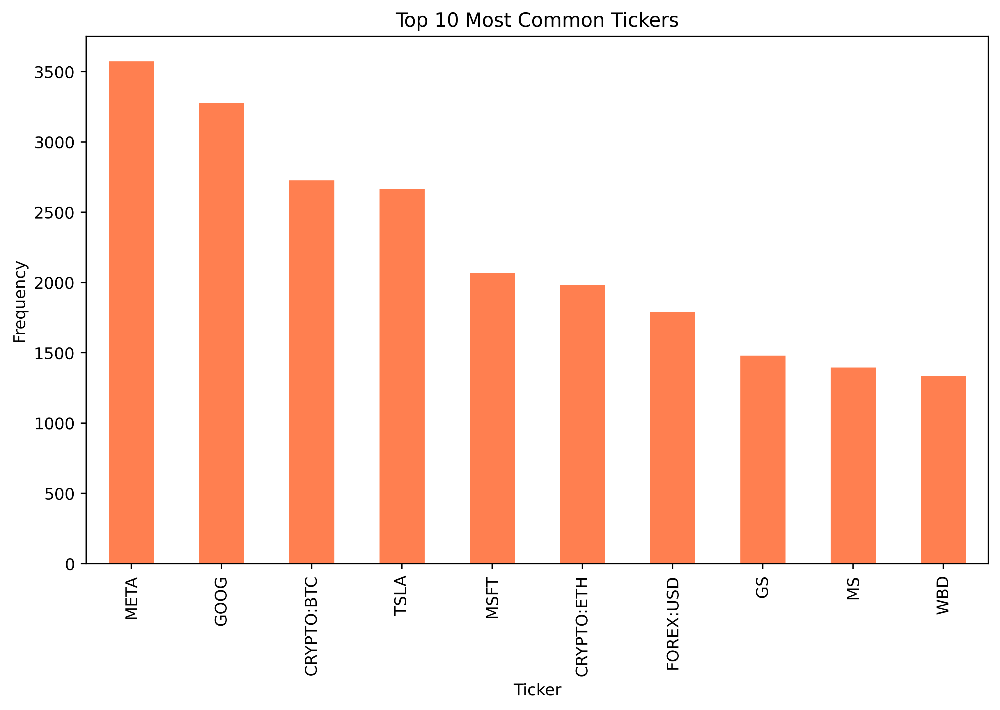

In [53]:
# Count the frequency of each ticker
ticker_counts = tickers_df['ticker'].value_counts().head(10)
print(f"Most common tickers:\n{ticker_counts}")

plt.figure(figsize=(10, 6), dpi=400)
ticker_counts.plot(kind='bar', color='coral')
plt.title('Top 10 Most Common Tickers')
plt.xlabel('Ticker')
plt.ylabel('Frequency')
plt.show()


Average sentiment score by ticker:
ticker
MGVMF    0.972796
AMIGF    0.846026
HSII     0.821466
BIOYF    0.731266
BBAI     0.728561
SSBK     0.695008
WNC      0.679559
YADGF    0.677655
ERMAF    0.673973
DUBRF    0.659081
Name: ticker_sentiment_score, dtype: float64


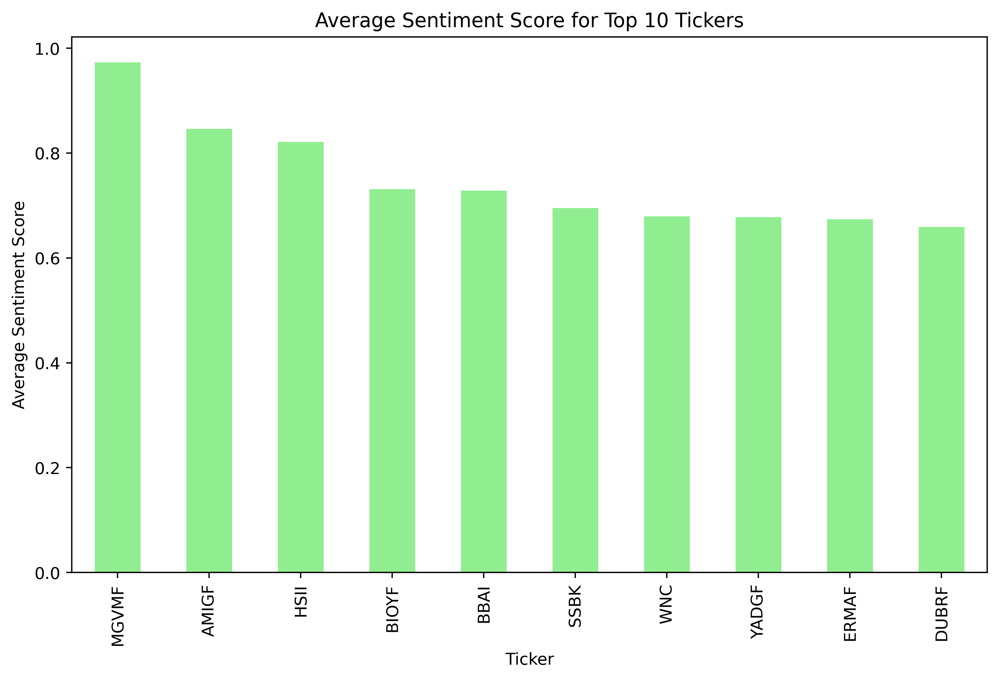

In [52]:
# average sentiment score for each ticker
average_sentiment_by_ticker = tickers_df.groupby('ticker')['ticker_sentiment_score'].mean().sort_values(ascending=False).head(10)
print(f"Average sentiment score by ticker:\n{average_sentiment_by_ticker}")

plt.figure(figsize=(10, 6), dpi=400)
average_sentiment_by_ticker.plot(kind='bar', color='lightgreen')
plt.title('Average Sentiment Score for Top 10 Tickers')
plt.xlabel('Ticker')
plt.ylabel('Average Sentiment Score')
plt.show()


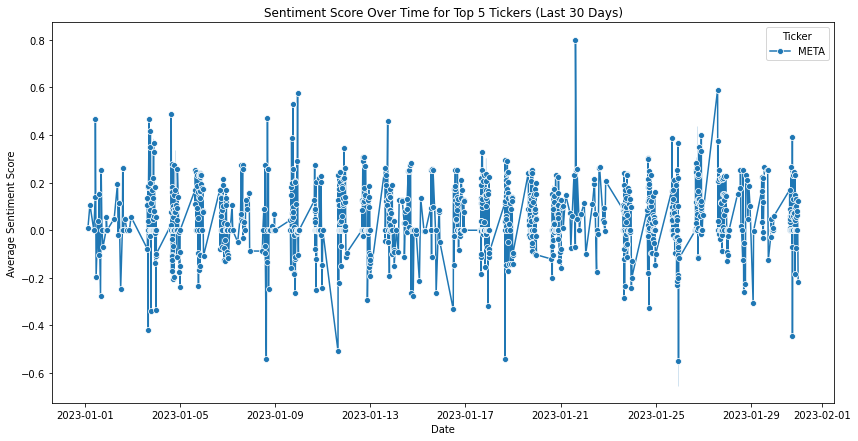

In [13]:

# Limit to the top 5 most common tickers
top_tickers = tickers_df['ticker'].value_counts().head(1).index
limited_tickers_df = tickers_df[tickers_df['ticker'].isin(top_tickers)]

# Limit to the last 30 days
last_30_days = limited_tickers_df['time_published'].max() - pd.Timedelta(days=30)
limited_tickers_df = limited_tickers_df[limited_tickers_df['time_published'] >= last_30_days]

# Plot sentiment over time for the top 5 tickers in the last 30 days
plt.figure(figsize=(14, 7))
sns.lineplot(x='time_published', y='ticker_sentiment_score', hue='ticker', data=limited_tickers_df, marker='o')
plt.title('Sentiment Score Over Time for Top 5 Tickers (Last 30 Days)')
plt.xlabel('Date')
plt.ylabel('Average Sentiment Score')
plt.legend(title='Ticker')
plt.show()


<ipython-input-54-ad6e34e62135>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='ticker', y='ticker_sentiment_score', data=tickers_df[tickers_df['ticker'].isin(ticker_counts.index)], palette='Set3')


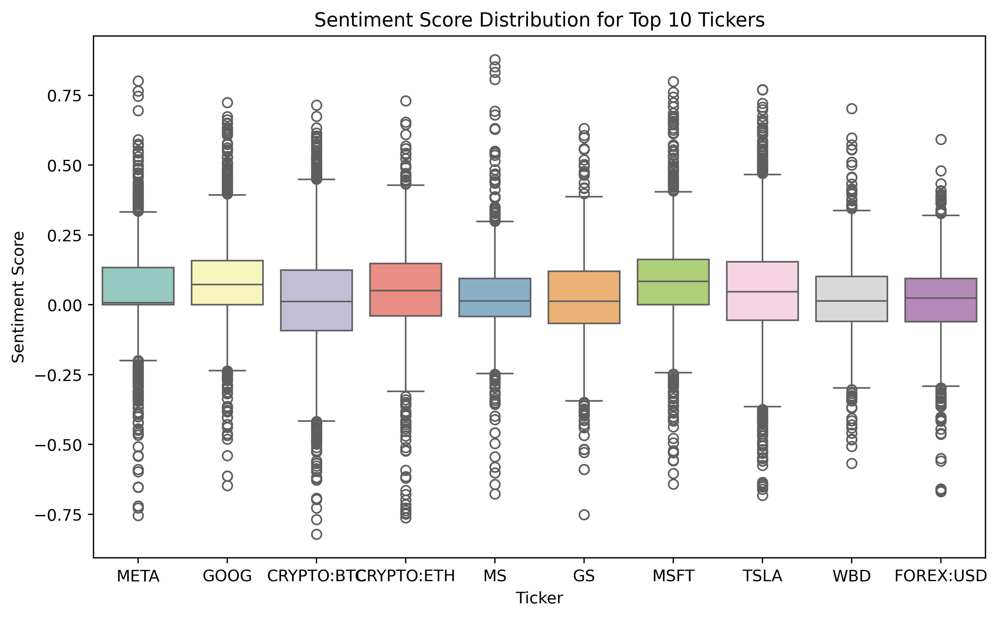

In [54]:
# Identify outliers using boxplot
plt.figure(figsize=(10, 6), dpi=400)
sns.boxplot(x='ticker', y='ticker_sentiment_score', data=tickers_df[tickers_df['ticker'].isin(ticker_counts.index)], palette='Set3')
plt.title('Sentiment Score Distribution for Top 10 Tickers')
plt.xlabel('Ticker')
plt.ylabel('Sentiment Score')
plt.show()


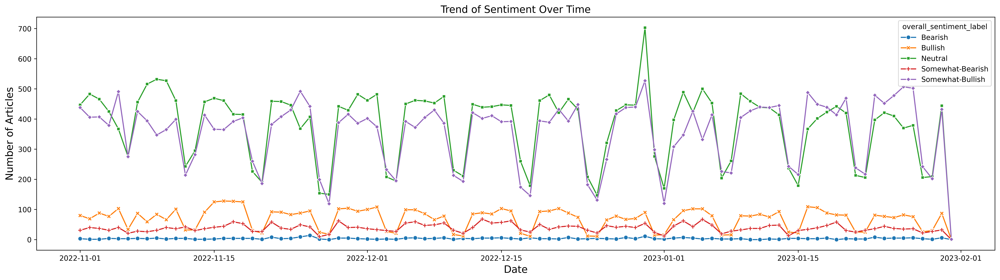

In [44]:
# Extract date part for daily sentiment analysis
df['date'] = df['time_published'].dt.date

# Aggregating sentiment count by date
sentiment_over_time = df.groupby(['date', 'overall_sentiment_label']).size().unstack(fill_value=0)
plt.figure(figsize=(24, 6), dpi=600)

# Plotting using seaborn
sns.lineplot(data=sentiment_over_time, markers=True, dashes=False)

# Adding titles and labels
plt.title('Trend of Sentiment Over Time', fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Articles', fontsize=14)

# Displaying the plot
plt.show()

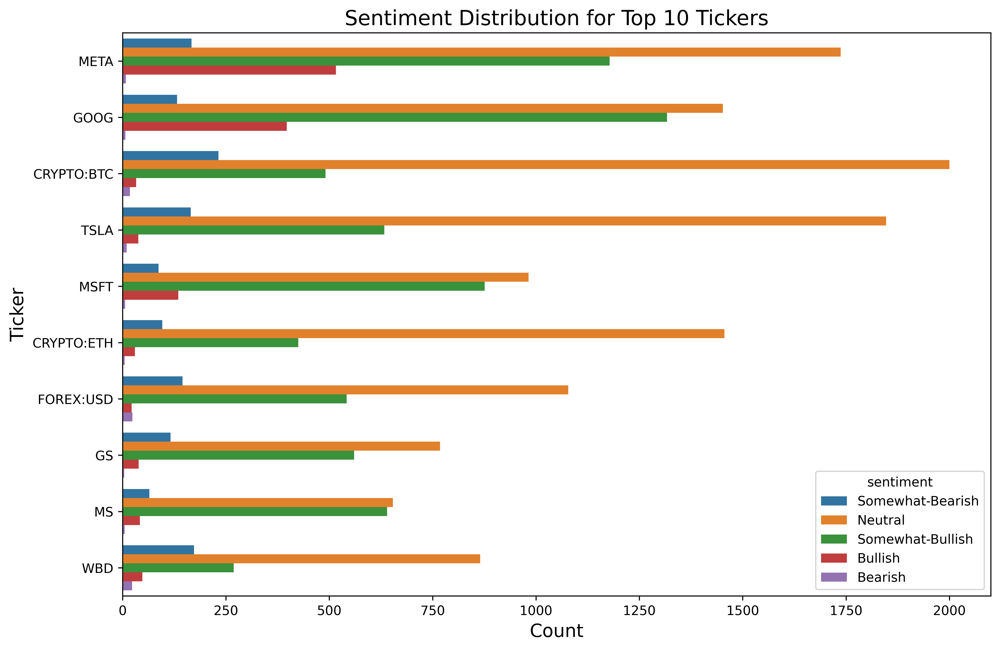

In [46]:
# Initialize an empty list to store the results
ticker_sentiments = []

# Iterate through each row in the DataFrame
for index, row in df.iterrows():
    # Iterate through the ticker sentiments in the current row
    for ticker in row['ticker_sentiment']:
        # Append the ticker and corresponding sentiment to the list
        ticker_sentiments.append({
            'ticker': ticker['ticker'], 
            'sentiment': row['overall_sentiment_label']
        })

# Convert the list of dictionaries to a DataFrame
ticker_df = pd.DataFrame(ticker_sentiments)


# Plotting sentiment distribution by ticker
plt.figure(figsize=(12, 8), dpi=600)
sns.countplot(y='ticker', hue='sentiment', data=ticker_df, order=ticker_df['ticker'].value_counts().index[:10])
plt.title('Sentiment Distribution for Top 10 Tickers', fontsize=16)
plt.xlabel('Count', fontsize=14)
plt.ylabel('Ticker', fontsize=14)
plt.show()


In [16]:
!pip install wordcloud


Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python3.9 -m pip install --upgrade pip


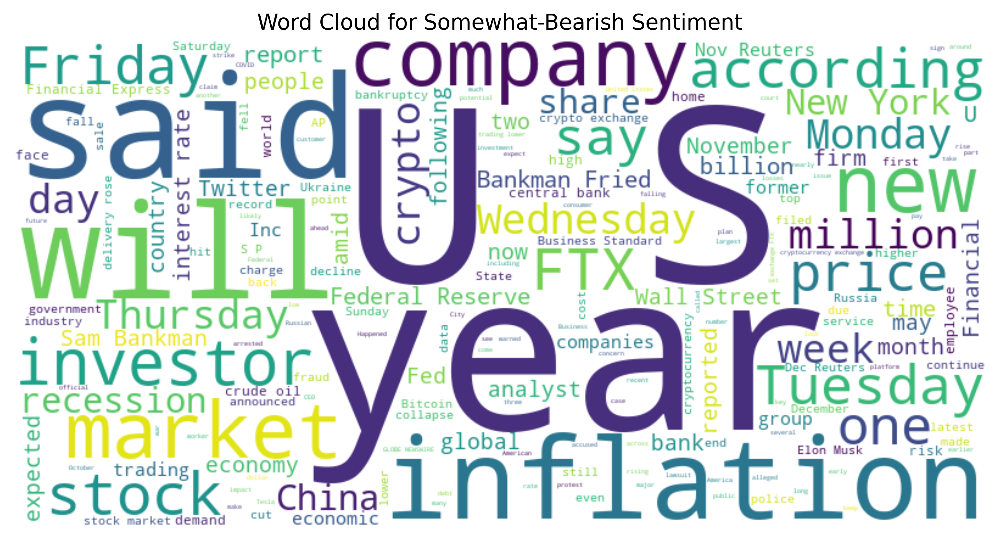

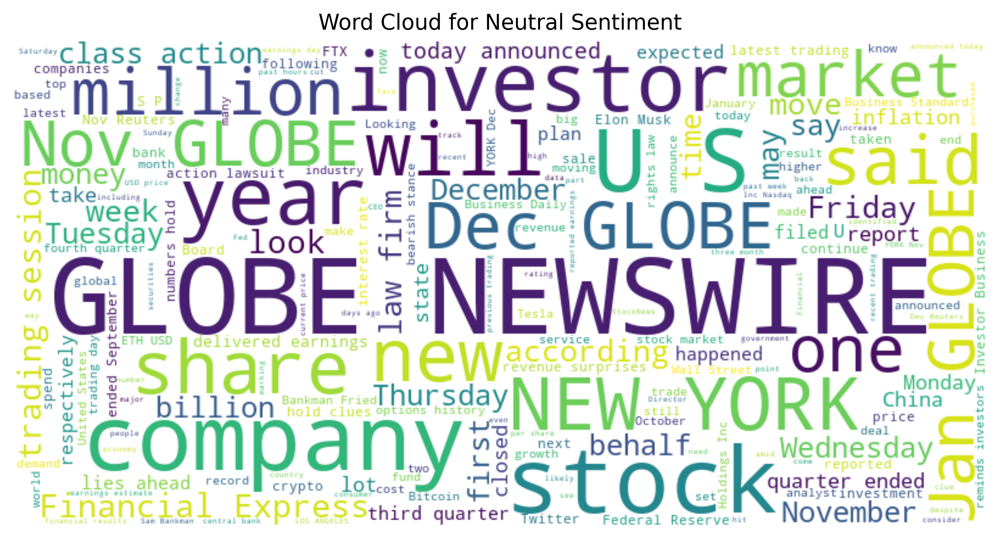

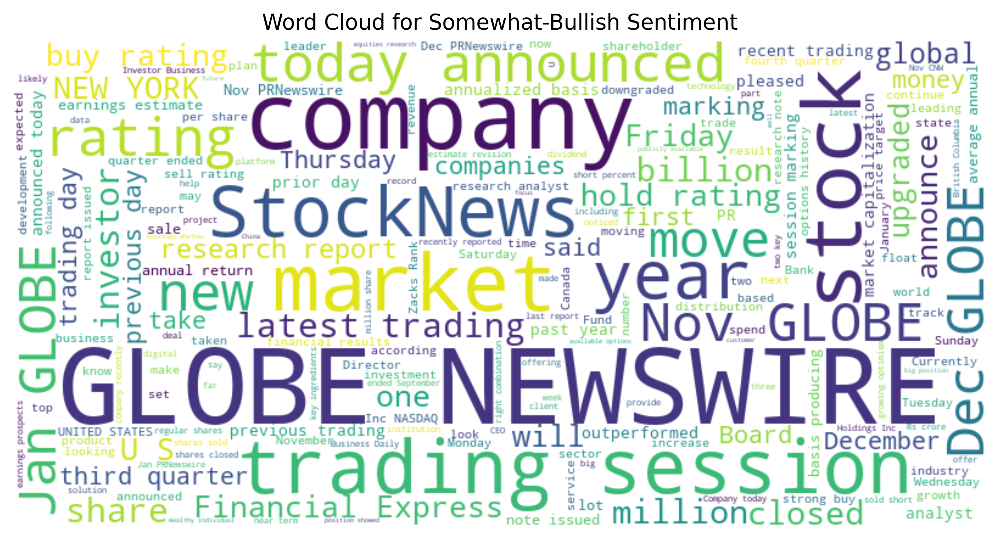

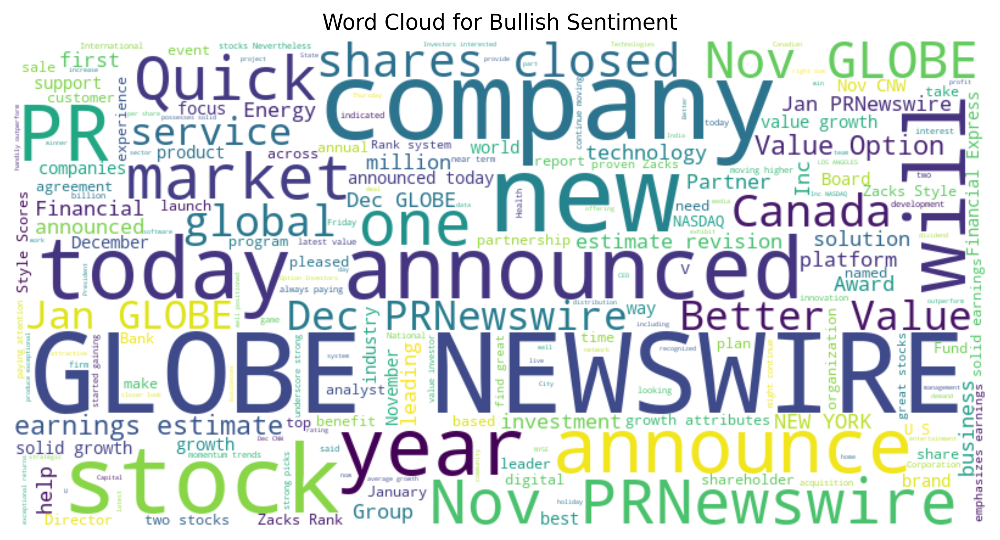

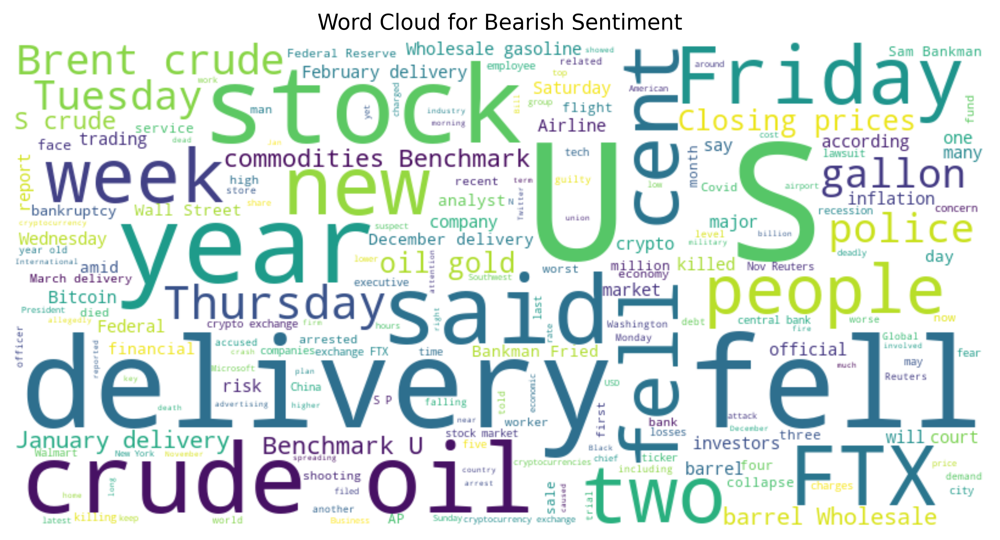

In [55]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Function to generate and display word clouds
def generate_word_cloud(data, sentiment_label):
    filtered_data = data[data['overall_sentiment_label'] == sentiment_label]
    if filtered_data.empty:
        print(f"No data available for {sentiment_label} sentiment.")
        return

    text = ' '.join(filtered_data['summary'].dropna().tolist())
    if len(text.strip()) == 0:
        print(f"No summary text available for {sentiment_label} sentiment.")
        return

    wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis').generate(text)

    plt.figure(figsize=(10, 5), dpi=400)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for {sentiment_label} Sentiment')
    plt.axis('off')
    plt.show()

# Generate word clouds for each sentiment label
for label in ['Somewhat-Bearish', 'Neutral', 'Somewhat-Bullish', 'Bullish', 'Bearish']:
    generate_word_cloud(df, label)


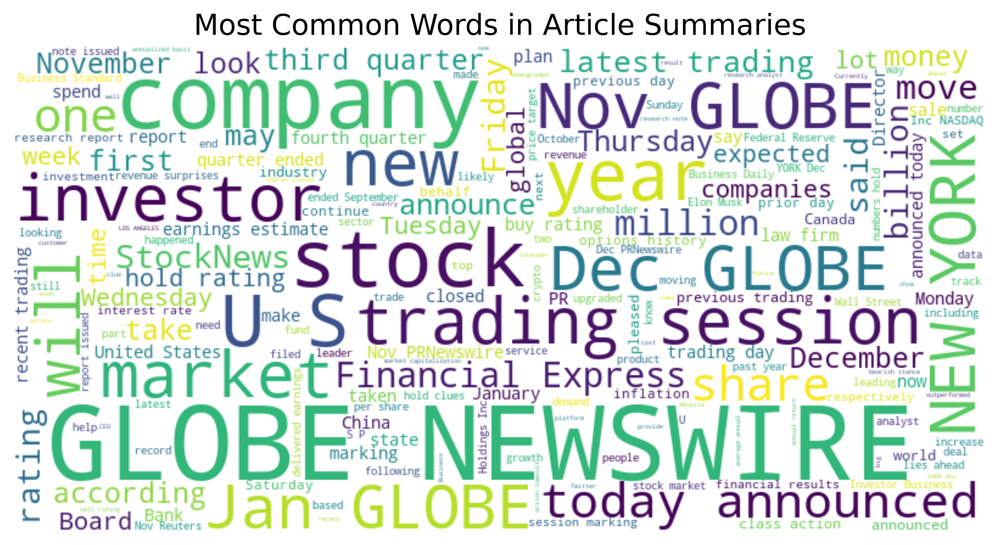

In [47]:
from wordcloud import WordCloud

# Combine all summaries into a single string
text = " ".join(summary for summary in df.summary)

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

# Display the word cloud
plt.figure(figsize=(10, 5), dpi=600)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title("Most Common Words in Article Summaries", fontsize=16)
plt.show()


<ipython-input-51-30c8d720513c>:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Frequency', y='Bigram', data=top_bigrams_df, palette='viridis')


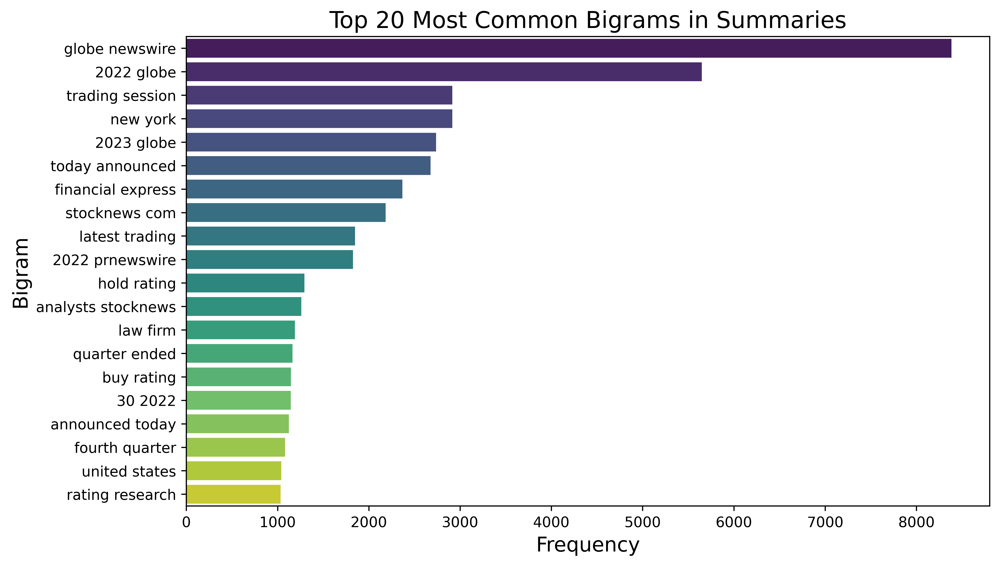

In [51]:
from sklearn.feature_extraction.text import CountVectorizer

# Function to extract n-grams (bigrams/trigrams)
def get_top_ngrams(corpus, n=None, ngram_range=(2, 2)):
    vec = CountVectorizer(ngram_range=ngram_range, stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
    return words_freq[:n]

# Get top 20 bigrams
top_bigrams = get_top_ngrams(df['summary'], n=20, ngram_range=(2, 2))

# Convert to DataFrame for plotting
top_bigrams_df = pd.DataFrame(top_bigrams, columns=['Bigram', 'Frequency'])

# Plotting the bigrams
plt.figure(figsize=(10, 6), dpi=600)
sns.barplot(x='Frequency', y='Bigram', data=top_bigrams_df, palette='viridis')
plt.title('Top 20 Most Common Bigrams in Summaries', fontsize=16)
plt.xlabel('Frequency', fontsize=14)
plt.ylabel('Bigram', fontsize=14)
plt.show()


In [23]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np

# combine summaries into a single string for each sentiment label
sentiment_groups = df.groupby('overall_sentiment_label')['summary'].apply(lambda x: ' '.join(x)).reset_index()

print(sentiment_groups.head())


  overall_sentiment_label                                            summary
0                 Bearish  Walshe was previously charged with misleading ...
1                 Bullish  SAN JOSE, Calif., Jan. 17, 2023 ( GLOBE NEWSWI...
2                 Neutral  Apparel sales slow down on price pressures The...
3        Somewhat-Bearish  The crypto industry has already seen more than...
4        Somewhat-Bullish  "The biggest theme is the rise of this 'life i...


In [24]:
tfidf = TfidfVectorizer(stop_words='english', max_features=100)

tfidf_matrix = tfidf.fit_transform(sentiment_groups['summary'])

tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), index=sentiment_groups['overall_sentiment_label'], columns=tfidf.get_feature_names_out())

print(tfidf_df)


                               10        11        12        15      2022  \
overall_sentiment_label                                                     
Bearish                  0.070752  0.044220  0.035376  0.044220  0.159192   
Bullish                  0.044083  0.030883  0.032626  0.038354  0.484411   
Neutral                  0.073533  0.042861  0.039233  0.037078  0.379116   
Somewhat-Bearish         0.053507  0.032869  0.032869  0.031340  0.153642   
Somewhat-Bullish         0.058045  0.035007  0.037750  0.040116  0.381429   

                             2023        30  according     ahead  analysts  \
overall_sentiment_label                                                      
Bearish                  0.088440  0.017688   0.114972  0.017688  0.053064   
Bullish                  0.221160  0.039351   0.014445  0.007472  0.016189   
Neutral                  0.172408  0.073986   0.067410  0.063781  0.032259   
Somewhat-Bearish         0.118480  0.046628   0.127653  0.042041  0.02

In [25]:
# top 10 words for each sentiment label
for label in tfidf_df.index:
    print(f"\nTop words in '{label}' sentiment:")
    print(tfidf_df.loc[label].sort_values(ascending=False).head(10))



Top words in 'Bearish' sentiment:
year         0.327229
said         0.327229
crypto       0.256477
stock        0.238788
friday       0.221100
new          0.212256
january      0.185724
thursday     0.176880
investors    0.176880
market       0.168036
Name: Bearish, dtype: float64

Top words in 'Bullish' sentiment:
2022          0.484411
prnewswire    0.236159
new           0.227138
company       0.225145
2023          0.221160
announced     0.205968
nov           0.201485
stocks        0.200738
today         0.200489
newswire      0.197002
Name: Bullish, dtype: float64

Top words in 'Neutral' sentiment:
2022         0.379116
company      0.287214
new          0.219521
stock        0.212774
newswire     0.208919
globe        0.199791
investors    0.196843
year         0.180799
market       0.172578
2023         0.172408
Name: Neutral, dtype: float64

Top words in 'Somewhat-Bearish' sentiment:
said         0.321807
year         0.285116
new          0.253776
inflation    0.226258
mar

In [26]:
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS

additional_stop_words = {'new', 'company', 'market', '2022', '2023', 'year'}
all_stop_words = ENGLISH_STOP_WORDS.union(additional_stop_words)

tfidf = TfidfVectorizer(stop_words=all_stop_words, max_features=100)

tfidf_matrix = tfidf.fit_transform(sentiment_groups['summary'])

tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), index=sentiment_groups['overall_sentiment_label'], columns=tfidf.get_feature_names_out())

print(tfidf_df)



                              000        10        11        12        15  \
overall_sentiment_label                                                     
Bearish                  0.070207  0.080237  0.050148  0.040119  0.050148   
Bullish                  0.032649  0.056656  0.039691  0.041932  0.049294   
Neutral                  0.064071  0.091519  0.053345  0.048829  0.046148   
Somewhat-Bearish         0.078770  0.061954  0.038058  0.038058  0.036287   
Somewhat-Bullish         0.030028  0.071128  0.042897  0.046259  0.049157   

                               16        30  according     ahead  analysts  \
overall_sentiment_label                                                      
Bearish                  0.040119  0.020059   0.130385  0.020059  0.060178   
Bullish                  0.055056  0.050575   0.018565  0.009603  0.020806   
Neutral                  0.044948  0.092084   0.083899  0.079383  0.040150   
Somewhat-Bearish         0.049563  0.053989   0.147805  0.048678  0.03

In [27]:
# Initialize the TF-IDF Vectorizer to use bigrams (two-word combinations)
tfidf = TfidfVectorizer(stop_words=all_stop_words, ngram_range=(1, 2), max_features=100)

tfidf_matrix = tfidf.fit_transform(sentiment_groups['summary'])

tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), index=sentiment_groups['overall_sentiment_label'], columns=tfidf.get_feature_names_out())

print(tfidf_df)


                               10        11        12        15        30  \
overall_sentiment_label                                                     
Bearish                  0.080550  0.050344  0.040275  0.050344  0.020137   
Bullish                  0.055017  0.038543  0.040719  0.047868  0.049112   
Neutral                  0.088649  0.051672  0.047297  0.044700  0.089195   
Somewhat-Bearish         0.062185  0.038199  0.038199  0.036422  0.054189   
Somewhat-Bullish         0.067154  0.040500  0.043675  0.046411  0.081110   

                         according     ahead  analysts  announced      bank  \
overall_sentiment_label                                                       
Bearish                   0.130893  0.020137  0.060412   0.020137  0.130893   
Bullish                   0.018028  0.009325  0.020204   0.257058  0.044138   
Neutral                   0.081267  0.076893  0.038891   0.136903  0.070878   
Somewhat-Bearish          0.148354  0.048859  0.034646   0.058631

In [57]:
# topic modeling
import ssl
import nltk

# Disable SSL certificate verification
ssl._create_default_https_context = ssl._create_unverified_context

# Now try to download the datasets again
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/naderlobandi/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     /Users/naderlobandi/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/naderlobandi/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [64]:
import pandas as pd
import gensim
from gensim import corpora
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
import nltk

# Initialize stop words and lemmatizer
stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()

# Function to preprocess text
def preprocess(text):
    tokens = word_tokenize(text.lower())  # Lowercase and tokenize
    tokens = [lemmatizer.lemmatize(word) for word in tokens if word.isalpha()]  # Lemmatize and remove non-alphabetic tokens
    tokens = [word for word in tokens if word not in stop_words]  # Remove stop words
    return tokens

# Apply preprocessing to the 'summary' column
df['processed_summary'] = df['summary'].apply(preprocess)


In [65]:
# Create a dictionary representation of the documents
dictionary = corpora.Dictionary(df['processed_summary'])

# Filter out extreme cases
dictionary.filter_extremes(no_below=15, no_above=0.5)

# Convert the documents into bag-of-words vectors
corpus = [dictionary.doc2bow(doc) for doc in df['processed_summary']]


In [66]:
# Apply LDA
lda_model = gensim.models.LdaMulticore(corpus, num_topics=5, id2word=dictionary, passes=10, workers=2)

# Display the top 5 topics
topics = lda_model.print_topics(num_words=10)
for i, topic in enumerate(topics):
    print(f"Topic {i + 1}: {topic}")


Topic 1: (0, '0.032*"ha" + 0.022*"earnings" + 0.019*"reported" + 0.019*"stock" + 0.015*"share" + 0.015*"market" + 0.014*"revenue" + 0.013*"quarter" + 0.013*"trade" + 0.012*"option"')
Topic 2: (1, '0.013*"new" + 0.010*"ha" + 0.008*"company" + 0.007*"business" + 0.006*"world" + 0.006*"global" + 0.006*"market" + 0.006*"said" + 0.005*"million" + 0.005*"service"')
Topic 3: (2, '0.038*"newswire" + 0.036*"globe" + 0.034*"company" + 0.024*"today" + 0.022*"announced" + 0.019*"trading" + 0.015*"closed" + 0.014*"session" + 0.013*"day" + 0.011*"share"')
Topic 4: (3, '0.013*"year" + 0.011*"market" + 0.011*"price" + 0.010*"ha" + 0.008*"week" + 0.007*"rate" + 0.006*"stock" + 0.006*"said" + 0.006*"could" + 0.006*"wa"')
Topic 5: (4, '0.047*"stock" + 0.027*"rating" + 0.020*"analyst" + 0.020*"investor" + 0.019*"share" + 0.018*"financial" + 0.017*"research" + 0.015*"buy" + 0.015*"report" + 0.015*"express"')


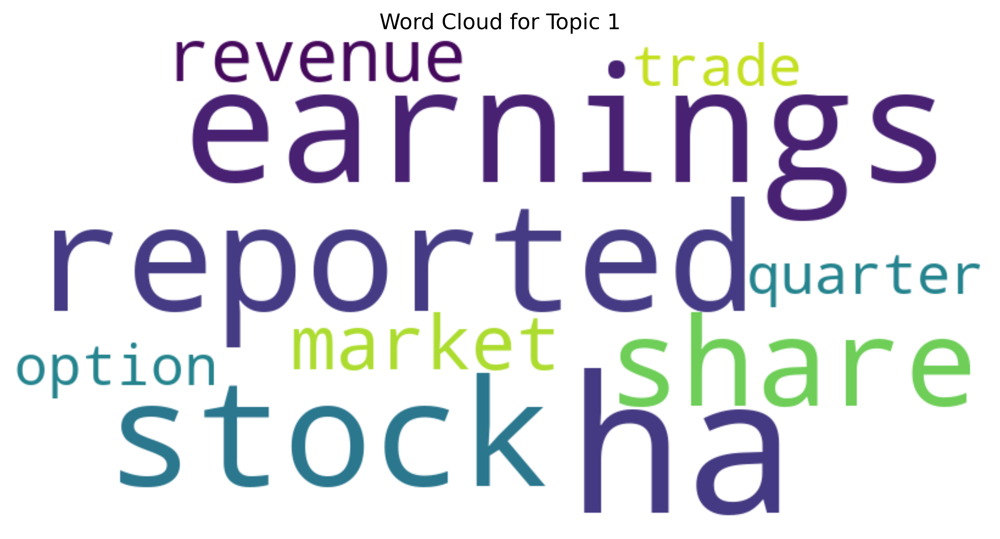

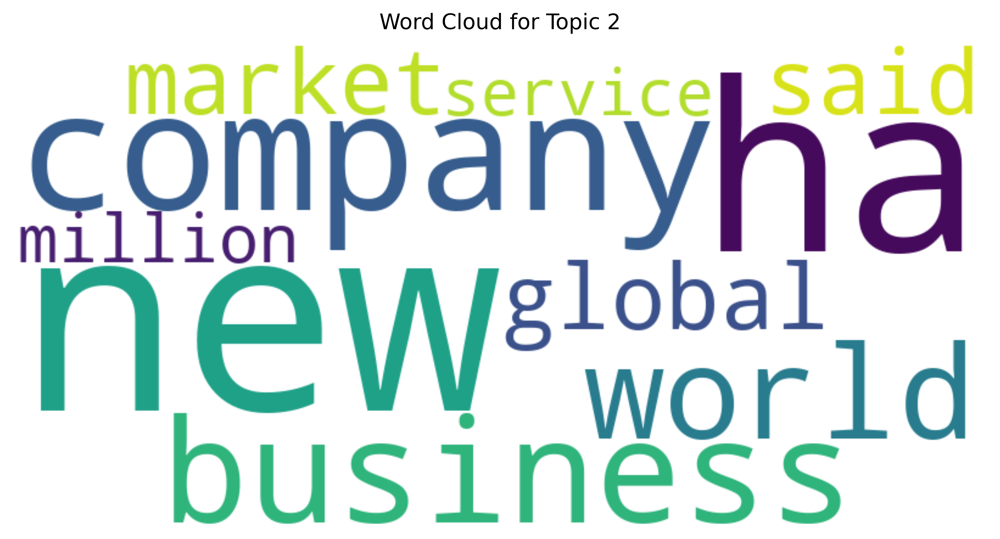

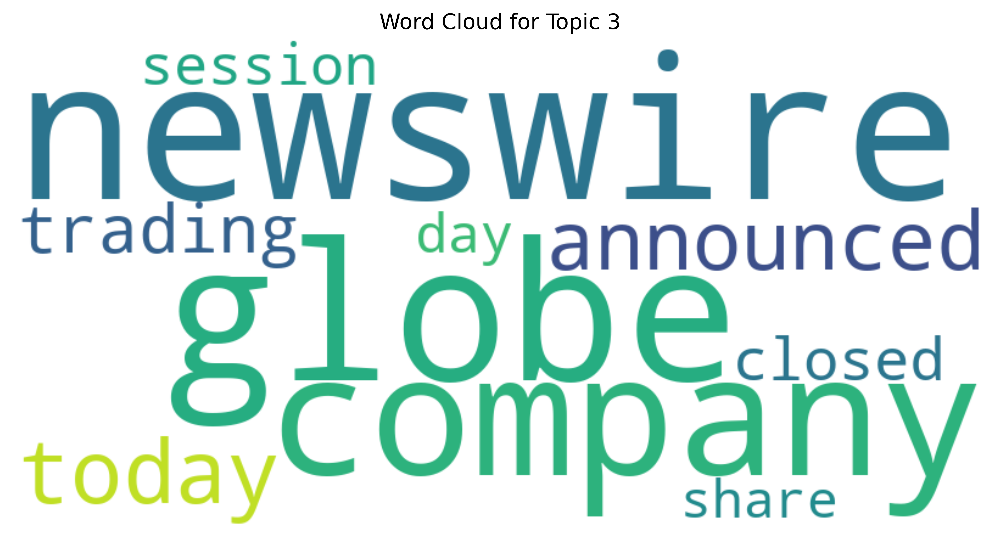

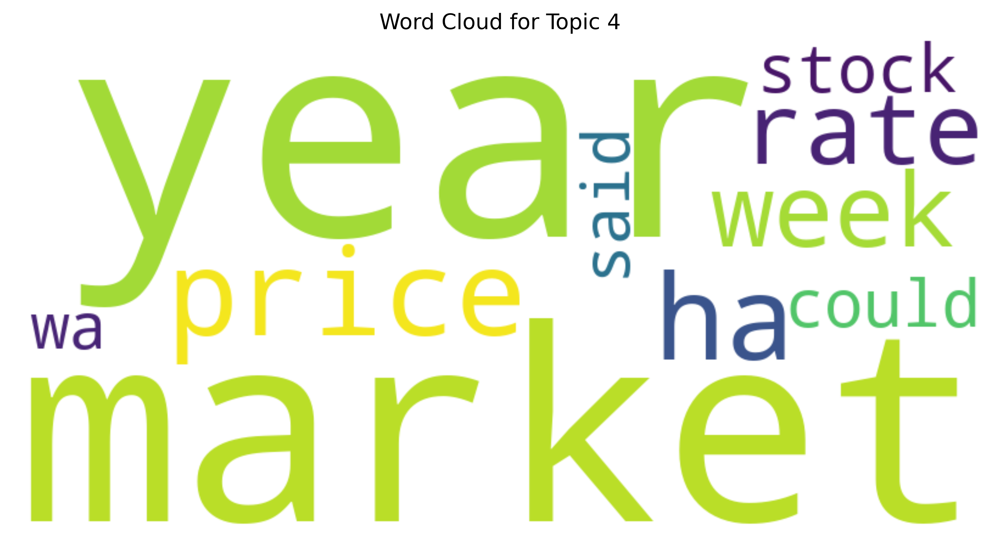

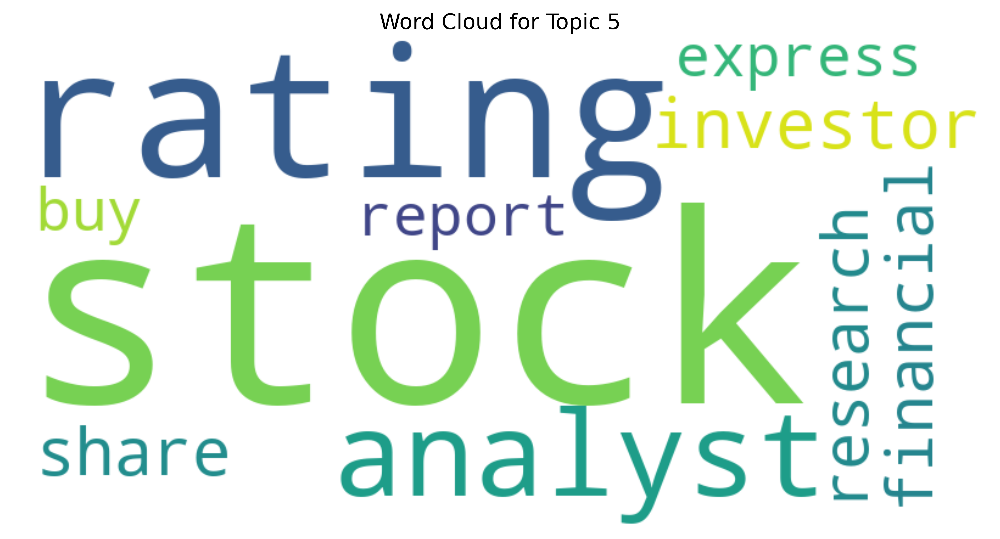

In [67]:
from wordcloud import WordCloud

# Function to plot a word cloud for a given topic
def plot_word_cloud(lda_model, topic_num, num_words=10):
    # Extract the words and their weights for the given topic
    words = lda_model.show_topic(topic_num, num_words)
    word_dict = {word: weight for word, weight in words}
    
    # Generate the word cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_dict)
    
    # Plot the word cloud
    plt.figure(figsize=(10, 5), dpi=600)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Word Cloud for Topic {topic_num + 1}")
    plt.show()

# Create a word cloud for each topic
for i in range(5):
    plot_word_cloud(lda_model, i)
